In [1]:
'''
Aqui fazemos a importação das bibliotecas necessárias, usando Numpy para
trabalhar com matrizes e Matplotlib para plotar os gráficos e as animações.
'''
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.animation import FuncAnimation
from matplotlib.animation import PillowWriter
from matplotlib import rc

%matplotlib inline

In [2]:
'''
Definindo as variáveis iniciais da simulação:
c: velocidade da onda. É o mesmo valo c que aparece na equação de onda.
L: tamanho do lado do quadrado
dx e dy: tamanho dos passos no espaço. Tomamos dx=dy, por simplificação.
tf: tempo final da simulação.
rx: variável utilizada simplificar as equações utilizadas.
'''
c = 5
L = 100
dx = 1
dy = dx
dt = 0.1
tf = 20
rx = c*dt/dx

m=1
n=1

'''
Função utilizada para definir a forma de uma onda gaussiana centrada em xc e yc e
com largura k (k altera a largura da onda inicial, quanto menor, maior a largura),
em t = 0. Retorna a matriz z das amplitudes da membrana por ponto com a membrana
em t = 0 dada pela função.
'''
def t0_gaussiana(x,y,z,xsize,ysize):
  for yi in range(0,ysize,1):
    for xi in range(0,xsize,1):
      xc = L/2
      yc = L/2
      k = .05
      z[0,xi,yi] = np.exp(-k*((x[xi]-xc)**2+(y[yi]-yc)**2))
  return z

'''
Função utilizada para definir a forma de 4 ondas gaussianas centradas em (L/4,L/4),
(3L/4,L/4), (L/4,3L/4) e (3L/4,3L/4) e com largura k (k altera a largura da onda
inicial, quanto menor, maior a largura),em t = 0. Retorna a matriz z das amplitudes 
da membrana por ponto com a membrana em t = 0 dada pela função.
'''
def t0_Ngaussiana(x,y,z,xsize,ysize):
  for yi in range(0,ysize,1):
    for xi in range(0,xsize,1):
      k = .05
      alfa = np.exp(-k*((x[xi]-(L/4))**2+(y[yi]-(L/4))**2))
      beta = np.exp(-k*((x[xi]-(3*L/4))**2+(y[yi]-(L/4))**2))
      gama = np.exp(-k*((x[xi]-(L/4))**2+(y[yi]-(3*L/4))**2))
      delta = np.exp(-k*((x[xi]-(3*L/4))**2+(y[yi]-(3*L/4))**2))
      z[0,xi,yi] = alfa + beta + gama + delta
  return z

'''
Função utilizada para definir a forma de uma matriz de ondas trigonométricas,em t = 0.
m e n: parâmetros que defines o número dos modos normais. Retorna a matriz z das
amplitudes da membrana por ponto com a membrana em t = 0 dada pela função.
'''
def t0_cos(x,y,z,xsize,ysize):
  for yi in range(0,ysize,1):
    for xi in range(0,xsize,1):
      z[0,xi,yi] = (np.sin(m*np.pi*x[xi]/L)*np.sin(n*np.pi*y[yi]/L)+np.sin(1*np.pi*x[xi]/L)*np.sin(1*np.pi*y[yi]/L))*0.5
  return z

'''
Função que calcula a evolução temporal da equação de onda bidimensional. O parametro
f é a função a ser utilizada para definir a membrana em t = 0. Retorna as matrizes
x e y das cordenadas na membrana e a matriz z com as t matrizes representando o
formato da membrana em cada ponto do tempo.
'''
def solve_fixedContour(f):
  t = np.arange(0, tf, dt)
  x = np.arange(0, L+dx, dx)
  y = np.arange(0, L+dy, dy)
  xsize = len(x); ysize = len(y); tsize = len(t)
  z = np.zeros( (tsize,xsize,ysize) )
  z = f(x,y,z,xsize,ysize)
  for ti in range(0,tsize-1,1):
    for xi in range(1,xsize-1,1):
      for yi in range(1,ysize-1,1):
        if (ti == 0):
          delta = (rx**2)*(z[ti,xi+1,yi] +z[ti,xi-1,yi] +z[ti,xi,yi+1] +z[ti,xi,yi-1] -4*z[ti,xi,yi])
          z[ti+1,xi,yi] = z[0,xi,yi] + delta
        else:
          delta = (rx**2)*(z[ti,xi+1,yi] +z[ti,xi-1,yi] +z[ti,xi,yi+1] +z[ti,xi,yi-1] -4*z[ti,xi,yi])
          z[ti+1,xi,yi] = 2*z[ti,xi,yi] -z[ti-1,xi,yi] + delta
  return x,y,z

In [3]:
'''
Função que plota a animação plana (curvas de nível) das solução calculadas da
equação de onda. Retorna um objeto com a animação finalizada.
'''
def plot_wave_contour(x,y,z):  
  def animate(it):
    for coll in ax.collections:
      plt.gca().collections.remove(coll)
    line = ax.contourf(x,y,z[it])
    return line
  fig, ax = plt.subplots(1,figsize=(6,6))
  ax.set_xlabel(r"x", fontsize=20)
  ax.set_ylabel(r"y", fontsize=20)
  ax.set_ylim((0, L))
  ax.set_xlim((0, L))
  ax.xaxis.grid(True, zorder=0)
  ax.yaxis.grid(True, zorder=0)
  t = np.arange(0, tf, dt)
  line = ax.contourf(x,y,z[0])
  anim = FuncAnimation(fig, animate, frames=round(tf/dt), interval=25)
  return anim

'''
Função que plota a animação tridimensional (superfície) das solução calculadas de
equação de onda. Retorna um objeto com a animação finalizada.
'''
def plot_wave_3d(x,y,z):  
  def animate(it):
    if (ax.collections != []):
      for coll in ax.collections:
        plt.gca().collections.remove(coll)
    X, Y = np.meshgrid(x, y)
    line = ax.plot_surface(X,Y,z[it], cmap=cm.coolwarm)
    return line
  fig = plt.figure(1,figsize=(4,4), dpi=100)
  ax = fig.add_subplot(projection='3d')
  #plt.tight_layout()
  ax.set_xlabel(r"x", fontsize=20)
  ax.set_ylabel(r"y", fontsize=20)
  ax.set_ylim((0, L))
  ax.set_xlim((0, L))
  ax.set_zlim((-1, 1))
  ax.xaxis.grid(True, zorder=0)
  ax.yaxis.grid(True, zorder=0)
  t = np.arange(0, tf, dt)
  anim = FuncAnimation(fig, animate, frames=round(tf/dt), interval=25)
  return anim

In [4]:
'''
As funções plot_double_3d e plot_double_contour plotam a superfície de z em dois momentos, t1 e t2, lado a
lado. Em plot_double_3d a plotagem é feita em projeção 3d e em plot_double_contour
a plotagem é feita em curvas de nível em uma projeção 2d.
Já a função plot_double_contour3d plota uma superfície de z num único tempo t em 
uma curva de níveis e em uma projeção 3d.
Parâmetros x,y,z são são as matrizes de coordenadas e valores de z da membrana
calculados e que serão plotados.
t, t1 e t1 são parâmetros de tempo e indicam o 'frame' a ser plotado, ou seja, é
um índice e não o valor de t diretamente
title, title1 e title 2 são títulos a serem passados para os plots. title é um título 
geral da imagem, title1 e title2 indicam o título de cada plot na imagem.
'''
def plot_double_3d(x,y,z,t1,t2,title,title1,title2):
  plt.clf()
  figt= plt.figure(figsize=(12,5))
  plt.subplots_adjust(left=0.1,right=0.98,wspace=0.1)
  figt.suptitle(title)
  axt = figt.add_subplot(1, 2, 1, projection='3d')
  axt.view_init(22, 45)
  axt.set_title(title1)
  axt.set_xlabel(r"x", fontsize=20)
  axt.set_ylabel(r"y", fontsize=20)
  axt.set_zlabel(r"z", fontsize=20)
  axt.set_ylim((0, L))
  axt.set_xlim((0, L))
  axt.set_zlim((-1, 1))
  axt.xaxis.grid(True, zorder=0)
  axt.yaxis.grid(True, zorder=0)
  Xt, Yt = np.meshgrid(x, y)
  axt.plot_surface(Xt,Yt,z[t1], cmap=cm.coolwarm)
  axt.get_xaxis().set_ticklabels([])
  axt = figt.add_subplot(1, 2, 2, projection='3d')
  axt.view_init(22, 45)
  axt.set_title(title2)
  axt.set_xlabel(r"x", fontsize=20)
  axt.set_ylabel(r"y", fontsize=20)
  axt.set_zlabel(r"z", fontsize=20)
  axt.set_ylim((0, L))
  axt.set_xlim((0, L))
  axt.set_zlim((-1, 1))
  axt.xaxis.grid(True, zorder=0)
  axt.yaxis.grid(True, zorder=0)
  Xt, Yt = np.meshgrid(x, y)
  axt.plot_surface(Xt,Yt,z[t2], cmap=cm.coolwarm)
  axt.get_yaxis().set_ticklabels([])
  return figt,axt

def plot_double_contour(x,y,z,t1,t2):
  plt.clf()
  figt= plt.figure(figsize=(11,5))
  axt = figt.add_subplot(1, 2, 1)
  axt.set_xlabel(r"x", fontsize=20)
  axt.set_ylabel(r"y", fontsize=20)
  axt.set_zlabel(r"z", fontsize=20)
  axt.set_ylim((0, L))
  axt.set_xlim((0, L))
  axt.xaxis.grid(True, zorder=0)
  axt.yaxis.grid(True, zorder=0)
  axt.contourf(x,y,z[t1], cmap=cm.coolwarm)
  axt = figt.add_subplot(1, 2, 2)
  axt.set_xlabel(r"x", fontsize=20)
  axt.set_ylabel(r"y", fontsize=20)
  axt.set_zlabel(r"z", fontsize=20)
  axt.set_ylim((0, L))
  axt.set_xlim((0, L))
  axt.xaxis.grid(True, zorder=0)
  axt.yaxis.grid(True, zorder=0)
  axt.contourf(x,y,z[t2], cmap=cm.coolwarm)
  return figt,axt

def plot_double_contour3d(x,y,z,t,title):
  plt.clf()
  figt= plt.figure(figsize=(11,5))
  plt.subplots_adjust(left=0.1,right=0.98,wspace=0.1)
  figt.suptitle(title)
  axt = figt.add_subplot(1, 2, 1)
  axt.set_xlabel(r"x", fontsize=20)
  axt.set_ylabel(r"y", fontsize=20)
  axt.set_ylim((0, L))
  axt.set_xlim((0, L))
  axt.xaxis.grid(True, zorder=0)
  axt.yaxis.grid(True, zorder=0)
  axt.contourf(x,y,z[t], cmap=cm.coolwarm)
  axt = figt.add_subplot(1, 2, 2, projection='3d')
  axt.view_init(30, 45)
  axt.set_xlabel(r"x", fontsize=20)
  axt.set_ylabel(r"y", fontsize=20)
  axt.set_zlabel(r"z", fontsize=20)
  axt.set_ylim((0, L))
  axt.set_xlim((0, L))
  axt.set_zlim((-1, 1))
  axt.xaxis.grid(True, zorder=0)
  axt.yaxis.grid(True, zorder=0)
  Xt, Yt = np.meshgrid(x, y)
  axt.plot_surface(Xt,Yt,z[t], cmap=cm.coolwarm)
  return figt,axt

<Figure size 640x480 with 0 Axes>

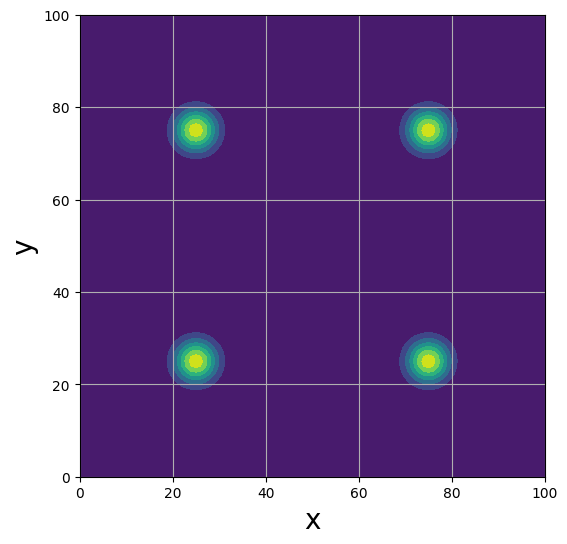

In [6]:
'''
Nesse trecho são executados os comandos gerais do código.
m e n: são colocados aqui para facilitar a plotagem e indicam o modo de vibração
a ser plotado no caso de t0_cos ser utilizado.
x1,y1,z1: são variaveis que guardam as coordenadas e os resultados das simulações
anim1: é a animação pronta
Por último a animação é salva em formato .gif
'''
m=2
n=2
plt.clf()
x1,y1,z1 = solve_fixedContour(t0_Ngaussiana)
anim1 = plot_wave_contour(x1,y1,z1)
rc('animation', html='jshtml')
writergif = PillowWriter(fps=30) 
#anim1.save(r"projeto2/gaussiana_Nonda_3d.gif", writer=writergif)
anim1

In [ ]:
# cria um arquivo zip de uma pasta
import shutil
shutil.make_archive('projeto2', 'zip', 'projeto2')

'/content/projeto2.zip'

Animation size has reached 21080143 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


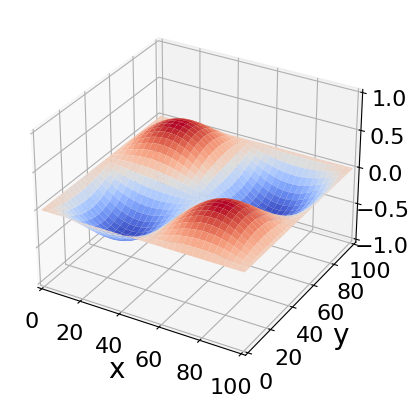

In [7]:
m=2
n=2
u=5
plt.clf()
plt.rc('font', size=16)
x1,y1,z1 = solve_fixedContour(t0_cos)
rc('animation', html='jshtml')
a = plot_wave_3d(x1,y1,z1)
a
#a,b = plot_double_3d(x1,y1,z1,0,u*10,'Sobreposição de Modos Normais m=1 e n=1 + m=2 e n=2','t=0','t='+str(u))
#a,b = plot_double_contour3d(x1,y1,z1,80,'Onda Gaussiana, t=8')